In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
print(tf.__version__)

2.0.0-beta1


In [2]:
data = pd.read_csv('DS_VF_Task_train.csv')

In [3]:
data = data[:10000]

In [7]:
def supervise(data,target,window_size):
    dataset = []
    labels = []
    for i in range(window_size,(len(data))):
        dataset.append(data.loc[i-window_size:i-1].values)
        labels.append(target[i])
    return dataset,labels

In [23]:
data.index = [i for i in range(0,len(data))]

In [9]:
labels = data.time_to_failure.to_list()

In [10]:
window_size = 20

In [11]:
data_train = pd.DataFrame(data.sensor_reading)

In [12]:
datset,target = supervise(data_train,labels,window_size)

In [23]:
def plot_series(time, series, start=0, end=None):
    plt.scatter(time[start:end], series[start:end])
    plt.xlabel("Time")
    plt.ylabel("Value")
    plt.grid(True)

In [17]:
len(datset),len(target)

(9980, 9980)

In [18]:
dataset  = np.concatenate(datset).reshape(len(datset),window_size,1)

In [19]:
dataset.shape

(9980, 20, 1)

In [20]:
target = np.array(target)

In [21]:
time = np.array([i for i in range(0,len(datset))])

In [46]:
ds = tf.expand_dims(datset, axis=-1)
ds = tf.data.Dataset.from_tensor_slices(ds)
ds = ds.window(window_size + 1, shift=1, drop_remainder=True)
ds = ds.flat_map(lambda w: w.batch(window_size + 1))
#ds = ds.shuffle(shuffle_buffer)
ds = ds.map(lambda w: (w[:-1], w[1:]))

tr = tf.data.Dataset.from_tensors((target))
#ds = ds.flat_map(lambda w: tf.data.Dataset.from_tensor_slices(w))

In [43]:
tf.concat([ds,tr],-1)

ValueError: Attempt to convert a value (<TensorDataset shapes: (9980, 20, 1), types: tf.int32>) with an unsupported type (<class 'tensorflow.python.data.ops.dataset_ops.TensorDataset'>) to a Tensor.

In [ ]:
for i in ds:iii
    for  val in i:
        print(val.numpy() )
    

tf.Tensor(
[[[[12]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[-5]]

  [[ 3]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[-1]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[ 5]]]


 [[[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[-5]]

  [[ 3]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[-1]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 4]]]


 [[[ 8]]

  [[ 5]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[-5]]

  [[ 3]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[-1]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 2]]]


 [[[ 5]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[-5]]

  [[ 3]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[-1]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 2]]

  [[ 6]]]


 [[[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[-5]]

  [[ 3]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[-1]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 2]]

 

  [[ 4]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 7]]

  [[ 7]]

  [[ 8]]

  [[14]]

  [[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 6]]]


 [[[ 7]]

  [[ 8]]

  [[14]]

  [[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 3]]]


 [[[ 8]]

  [[14]]

  [[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[ 4]]]


 [[[14]]

  [[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 2]]]


 [[[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 3]]

  

  [[ 8]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 2]]

  [[ 3]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[11]]

  [[11]]

  [[11]]

  [[ 2]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 0]]

  [[-4]]

  [[ 2]]

  [[ 5]]]


 [[[ 3]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[11]]

  [[11]]

  [[11]]

  [[ 2]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 0]]

  [[-4]]

  [[ 2]]

  [[ 5]]

  [[ 4]]]


 [[[10]]

  [[ 6]]

  [[ 8]]

  [[11]]

  [[11]]

  [[11]]

  [[ 2]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 0]]

  [[-4]]

  [[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 4]]]


 [[[ 6]]

  [[ 8]]

  [[11]]

  [[11]]

  [[11]]

  [[ 2]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 0]]

  [[-4]]

  [[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 4]]

  [[ 6]]]


 [[[ 8]]

  [[11]]

  [[11]]

  [[11]]

  [[ 2]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 0]]

 

  [[ 1]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 6]]

  [[ 9]]

  [[ 6]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[13]]

  [[ 8]]

  [[ 9]]]


 [[[ 9]]

  [[ 6]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[13]]

  [[ 8]]

  [[ 9]]

  [[ 6]]]


 [[[ 6]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[13]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 6]]]


 [[[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[13]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 6]]

  [[-2]]]


 [[[ 0]]

  [[ 4]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  

  [[-1]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 6]]

  [[ 6]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 6]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[-1]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 1]]]


 [[[ 6]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 6]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[-1]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 1]]]


 [[[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 6]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[-1]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 1]]

  [[ 6]]]


 [[[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 6]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[-1]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 1]]

  [[ 6]]

  [[ 7]]]


 [[[ 2]]

  [[ 3]]

  [[ 6]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[-1]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  

  [[12]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 6]]

  [[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 8]]]


 [[[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[ 3]]]


 [[[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 3]]]


 [[[ 8]]

  [[ 6]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 3]]

  [[ 5]]]


 [[[ 6]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 7]]

  

tf.Tensor(
[[[[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 1]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[13]]

  [[12]]

  [[ 5]]

  [[ 9]]

  [[ 3]]]


 [[[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 1]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[13]]

  [[12]]

  [[ 5]]

  [[ 9]]

  [[ 3]]

  [[ 0]]]


 [[[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 1]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[13]]

  [[12]]

  [[ 5]]

  [[ 9]]

  [[ 3]]

  [[ 0]]

  [[-4]]]


 [[[ 7]]

  [[ 4]]

  [[ 1]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[13]]

  [[12]]

  [[ 5]]

  [[ 9]]

  [[ 3]]

  [[ 0]]

  [[-4]]

  [[ 2]]]


 [[[ 4]]

  [[ 1]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[13]]

  [[12]]

  [[ 5]]

  [[ 9]]

  [[ 3]]

  [[ 0]]

  [[-4]]

 

  [[ 3]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 2]]

  [[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[15]]

  [[11]]

  [[ 7]]

  [[ 7]]

  [[11]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[ 3]]

  [[ 4]]

  [[ 5]]]


 [[[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[15]]

  [[11]]

  [[ 7]]

  [[ 7]]

  [[11]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[ 3]]

  [[ 4]]

  [[ 5]]

  [[ 8]]]


 [[[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[15]]

  [[11]]

  [[ 7]]

  [[ 7]]

  [[11]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[ 3]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 7]]]


 [[[ 7]]

  [[ 9]]

  [[ 8]]

  [[15]]

  [[11]]

  [[ 7]]

  [[ 7]]

  [[11]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[ 3]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 7]]

  [[ 8]]]


 [[[ 9]]

  [[ 8]]

  [[15]]

  [[11]]

  [[ 7]]

  [[ 7]]

  [[11]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-4]]

  [[ 0]]

  [[-1]]

 

  [[10]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 8]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[ 7]]]


 [[[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 6]]]


 [[[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 6]]

  [[ 4]]]


 [[[ 8]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 6]]

  [[ 4]]

  [[ 7]]]


 [[[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 3]]

  

  [[ 3]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 5]]

  [[ 7]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[10]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[10]]

  [[ 6]]

  [[-1]]

  [[ 0]]

  [[ 2]]

  [[-1]]

  [[-4]]]


 [[[ 7]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[10]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[10]]

  [[ 6]]

  [[-1]]

  [[ 0]]

  [[ 2]]

  [[-1]]

  [[-4]]

  [[-2]]]


 [[[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[10]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[10]]

  [[ 6]]

  [[-1]]

  [[ 0]]

  [[ 2]]

  [[-1]]

  [[-4]]

  [[-2]]

  [[ 1]]]


 [[[ 0]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[10]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[10]]

  [[ 6]]

  [[-1]]

  [[ 0]]

  [[ 2]]

  [[-1]]

  [[-4]]

  [[-2]]

  [[ 1]]

  [[ 4]]]


 [[[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 8]]

  [[10]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[10]]

  [[ 6]]

  [[-1]]

  [[ 0]]

 

tf.Tensor(
[[[[ 4]]

  [[ 5]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[10]]

  [[10]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 3]]

  [[-1]]

  [[-5]]

  [[-1]]]


 [[[ 5]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[10]]

  [[10]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 3]]

  [[-1]]

  [[-5]]

  [[-1]]

  [[ 4]]]


 [[[ 1]]

  [[ 2]]

  [[ 6]]

  [[10]]

  [[10]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 3]]

  [[-1]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 5]]]


 [[[ 2]]

  [[ 6]]

  [[10]]

  [[10]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 3]]

  [[-1]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 5]]

  [[ 7]]]


 [[[ 6]]

  [[10]]

  [[10]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 3]]

  [[-1]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 5]]

 

tf.Tensor(
[[[[ 4]]

  [[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 4]]

  [[ 3]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[13]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 7]]]


 [[[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 4]]

  [[ 3]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[13]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 7]]]


 [[[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 4]]

  [[ 3]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[13]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 4]]]


 [[[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 4]]

  [[ 3]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[13]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 4]]]


 [[[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 4]]

  [[ 3]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[13]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

 

  [[-4]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 4]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[-2]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 2]]

  [[ 5]]

  [[ 7]]]


 [[[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[-2]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]]


 [[[ 2]]

  [[ 3]]

  [[ 6]]

  [[ 2]]

  [[-2]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 2]]]


 [[[ 3]]

  [[ 6]]

  [[ 2]]

  [[-2]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 2]]

  [[ 2]]]


 [[[ 6]]

  [[ 2]]

  [[-2]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  

tf.Tensor(
[[[[ 2]]

  [[ 0]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 9]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[10]]]


 [[[ 0]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 9]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[10]]

  [[ 9]]]


 [[[-3]]

  [[ 1]]

  [[ 1]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 9]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 9]]]


 [[[ 1]]

  [[ 1]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 9]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 9]]

  [[ 3]]]


 [[[ 1]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 9]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 9]

  [[ 5]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 3]]

  [[10]]

  [[ 9]]

  [[ 9]]

  [[ 3]]

  [[-3]]

  [[-2]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[-2]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 8]]]


 [[[10]]

  [[ 9]]

  [[ 9]]

  [[ 3]]

  [[-3]]

  [[-2]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[-2]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 8]]

  [[ 6]]]


 [[[ 9]]

  [[ 9]]

  [[ 3]]

  [[-3]]

  [[-2]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[-2]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 7]]]


 [[[ 9]]

  [[ 3]]

  [[-3]]

  [[-2]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[-2]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 5]]]


 [[[ 3]]

  [[-3]]

  [[-2]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[-2]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[12]]

  

  [[ 4]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[-1]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[11]]

  [[ 5]]]


 [[[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[-1]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[11]]

  [[ 5]]

  [[ 7]]]


 [[[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[-1]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[11]]

  [[ 5]]

  [[ 7]]

  [[ 5]]]


 [[[ 7]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[-1]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[11]]

  [[ 5]]

  [[ 7]]

  [[ 5]]

  [[ 4]]]


 [[[ 5]]

  [[ 9]]

  [[10]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[-1]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

 

  [[ 4]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 4]]

  [[ 8]]

  [[13]]

  [[ 8]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]]


 [[[ 8]]

  [[13]]

  [[ 8]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 4]]]


 [[[13]]

  [[ 8]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 4]]

  [[ 2]]]


 [[[ 8]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 4]]

  [[ 2]]

  [[ 4]]]


 [[[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

 

  [[ 2]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 2]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 9]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[ 9]]

  [[ 5]]

  [[ 7]]

  [[ 4]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 6]]

  [[ 6]]]


 [[[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 9]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[ 9]]

  [[ 5]]

  [[ 7]]

  [[ 4]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[ 3]]]


 [[[ 5]]

  [[ 8]]

  [[ 9]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[ 9]]

  [[ 5]]

  [[ 7]]

  [[ 4]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 8]]]


 [[[ 8]]

  [[ 9]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[ 9]]

  [[ 5]]

  [[ 7]]

  [[ 4]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 8]]

  [[ 5]]]


 [[[ 9]]

  [[ 4]]

  [[ 4]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[ 9]]

  [[ 5]]

  [[ 7]]

  [[ 4]]

  [[ 0]]

  [[ 5]]

 

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 5]]

  [[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 2]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[-2]]

  [[ 5]]

  [[10]]]


 [[[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 2]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[-2]]

  [[ 5]]

  [[10]]

  [[ 8]]]


 [[[ 0]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 2]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[-2]]

  [[ 5]]

  [[10]]

  [[ 8]]

  [[ 9]]]


 [[[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 2]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[-2]]

  [[ 5]]

  [[10]]

  [[ 8]]

  [[ 9]]

  [[11]]]


 [[[ 0]]

  [[ 6]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 2]]

  [[ 4]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[11]]

  [[ 9]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[ 9]]

  [[ 9]]

  [[ 8]]]


 [[[ 9]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]]


 [[[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]]


 [[[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]

  [[ 1]]]


 [[[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

 

tf.Tensor(
[[[[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 1]]

  [[ 6]]]


 [[[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 2]]]


 [[[ 5]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 2]]

  [[-2]]]


 [[[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 2]]

  [[-2]]

  [[ 4]]]


 [[[ 4]]

  [[ 3]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 2]]

  [[-2]]

 

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 9]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 1]]

  [[ 9]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[13]]

  [[ 6]]

  [[ 7]]]


 [[[10]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 1]]

  [[ 9]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]]


 [[[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 1]]

  [[ 9]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 3]]]


 [[[ 6]]

  [[ 2]]

  [[ 1]]

  [[ 9]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 3]]

  [[ 7]]]


 [[[ 2]]

  [[ 1]]

  [[ 9]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 6]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

 

  [[ 8]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 7]]

  [[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 6]]

  [[ 5]]

  [[13]]

  [[ 7]]

  [[ 6]]

  [[ 6]]]


 [[[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 6]]

  [[ 5]]

  [[13]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 0]]]


 [[[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 6]]

  [[ 5]]

  [[13]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 0]]

  [[ 8]]]


 [[[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 6]]

  [[ 5]]

  [[13]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 0]]

  [[ 8]]

  [[ 6]]]


 [[[ 7]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 7]]

  [[ 7]]

  [[ 8]]

  [[ 6]]

  [[ 5]]

  [[13]]

  

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 8]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 6]]

  [[ 4]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 2]]]


 [[[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 6]]

  [[ 4]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 2]]

  [[ 3]]]


 [[[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 6]]

  [[ 4]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 9]]]


 [[[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 6]]

  [[ 4]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[ 5]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 9]]

  [[ 5]]]


 [[[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 4]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 6]]

  [[ 4]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  

  [[ 7]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 2]]

  [[ 3]]

  [[ 9]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[-3]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[12]]]


 [[[ 3]]

  [[ 9]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[-3]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]]


 [[[ 9]]

  [[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[-3]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]]


 [[[ 5]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[-3]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 6]]]


 [[[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[-1]]

  [[ 6]]

  [[ 6]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[-3]]

  [[-1]]

 

  [[ 3]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[-2]]

  [[-4]]]


 [[[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[-2]]

  [[-4]]

  [[-2]]]


 [[[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[-2]]

  [[-4]]

  [[-2]]

  [[ 3]]]


 [[[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[-2]]

  [[-4]]

  [[-2]]

  [[ 3]]

  [[ 3]]]


 [[[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 4]]

  [[ 7]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  

  [[ 3]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 9]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  [[-1]]

  [[ 4]]

  [[ 2]]]


 [[[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 9]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  [[-1]]

  [[ 4]]

  [[ 2]]

  [[ 4]]]


 [[[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 9]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  [[-1]]

  [[ 4]]

  [[ 2]]

  [[ 4]]

  [[ 8]]]


 [[[ 4]]

  [[ 7]]

  [[ 9]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  [[-1]]

  [[ 4]]

  [[ 2]]

  [[ 4]]

  [[ 8]]

  [[ 5]]]


 [[[ 7]]

  [[ 9]]

  [[ 5]]

  [[ 2]]

  [[ 3]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  
tf.Tensor(
[[[[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 7]]

  [[11]]

  [[11]]

  [[ 8]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 2]]]


 [[[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 7]]

  [[11]]

  [[11]]

  [[ 8]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 1]]]


 [[[ 5]]

  [[ 5]]

  [[ 7]]

  [[11]]

  [[11]]

  [[ 8]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 1]]

  [[ 5]]]


 [[[ 5]]

  [[ 7]]

  [[11]]

  [[11]]

  [[ 8]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 1]]

  [[ 5]]

  [[ 6]]]


 [[[ 7]]

  [[11]]

  [[11]]

  [[ 8]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 1]]

  [[ 5]]

tf.Tensor(
[[[[ 5]]

  [[ 6]]

  [[ 9]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 9]]]


 [[[ 6]]

  [[ 9]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 8]]]


 [[[ 9]]

  [[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 5]]]


 [[[ 6]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 5]]

  [[ 7]]]


 [[[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 5]]

 

tf.Tensor(
[[[[ 7]]

  [[ 2]]

  [[10]]

  [[15]]

  [[11]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 4]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[10]]]


 [[[ 2]]

  [[10]]

  [[15]]

  [[11]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 4]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[10]]

  [[ 6]]]


 [[[10]]

  [[15]]

  [[11]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 4]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 7]]]


 [[[15]]

  [[11]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 4]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 7]]

  [[ 6]]]


 [[[11]]

  [[ 4]]

  [[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 4]]

  [[ 1]]

  [[ 3]]

  [[ 1]]

  [[ 4]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[10]]

  [[ 6]]

  [[ 7]]

 

tf.Tensor(
[[[[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 0]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[10]]

  [[10]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 3]]

  [[ 5]]

  [[ 6]]]


 [[[ 7]]

  [[ 9]]

  [[ 6]]

  [[ 0]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[10]]

  [[10]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 2]]]


 [[[ 9]]

  [[ 6]]

  [[ 0]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[10]]

  [[10]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 3]]]


 [[[ 6]]

  [[ 0]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[10]]

  [[10]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 3]]

  [[ 9]]]


 [[[ 0]]

  [[ 0]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[10]]

  [[10]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 2]]

  [[ 3]]

 

  [[21]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 9]]

  [[ 5]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

  [[11]]

  [[15]]

  [[11]]

  [[12]]]


 [[[ 5]]

  [[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

  [[11]]

  [[15]]

  [[11]]

  [[12]]

  [[ 7]]]


 [[[ 2]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

  [[11]]

  [[15]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]]


 [[[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

  [[11]]

  [[15]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]

  [[ 7]]]


 [[[ 4]]

  [[ 3]]

  [[-4]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

  [[11]]

  

  [[-24]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[  7]]

  [[  0]]

  [[  0]]

  [[ -2]]

  [[ -6]]

  [[ -7]]

  [[ -7]]

  [[ -4]]

  [[ -2]]

  [[  5]]

  [[  9]]

  [[ 19]]

  [[ 24]]

  [[ 27]]

  [[ 27]]

  [[ 21]]

  [[ 19]]

  [[ 14]]

  [[  3]]

  [[ -7]]]


 [[[  0]]

  [[  0]]

  [[ -2]]

  [[ -6]]

  [[ -7]]

  [[ -7]]

  [[ -4]]

  [[ -2]]

  [[  5]]

  [[  9]]

  [[ 19]]

  [[ 24]]

  [[ 27]]

  [[ 27]]

  [[ 21]]

  [[ 19]]

  [[ 14]]

  [[  3]]

  [[ -7]]

  [[ -8]]]


 [[[  0]]

  [[ -2]]

  [[ -6]]

  [[ -7]]

  [[ -7]]

  [[ -4]]

  [[ -2]]

  [[  5]]

  [[  9]]

  [[ 19]]

  [[ 24]]

  [[ 27]]

  [[ 27]]

  [[ 21]]

  [[ 19]]

  [[ 14]]

  [[  3]]

  [[ -7]]

  [[ -8]]

  [[-11]]]


 [[[ -2]]

  [[ -6]]

  [[ -7]]

  [[ -7]]

  [[ -4]]

  [[ -2]]

  [[  5]]

  [[  9]]

  [[ 19]]

  [[ 24]]

  [[ 27]]

  [[ 27]]

  [[ 21]]

  [[ 19]]

  [[ 14]]

  [[  3]]

  [[ -7]]

  [[ -8]]

  [[-11]]

  [[-12]]]


 [[[ -6]]

  [[ -7]]

  [[ -7]]

  [[ -4]]

  [[ -

  [[  6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ -8]]

  [[-11]]

  [[-12]]

  [[-11]]

  [[ -7]]

  [[  0]]

  [[ 12]]

  [[ 12]]

  [[ 18]]

  [[ 25]]

  [[ 26]]

  [[ 21]]

  [[ 13]]

  [[  6]]

  [[ -2]]

  [[-14]]

  [[-22]]

  [[-26]]

  [[-24]]

  [[-20]]]


 [[[-11]]

  [[-12]]

  [[-11]]

  [[ -7]]

  [[  0]]

  [[ 12]]

  [[ 12]]

  [[ 18]]

  [[ 25]]

  [[ 26]]

  [[ 21]]

  [[ 13]]

  [[  6]]

  [[ -2]]

  [[-14]]

  [[-22]]

  [[-26]]

  [[-24]]

  [[-20]]

  [[-15]]]


 [[[-12]]

  [[-11]]

  [[ -7]]

  [[  0]]

  [[ 12]]

  [[ 12]]

  [[ 18]]

  [[ 25]]

  [[ 26]]

  [[ 21]]

  [[ 13]]

  [[  6]]

  [[ -2]]

  [[-14]]

  [[-22]]

  [[-26]]

  [[-24]]

  [[-20]]

  [[-15]]

  [[ -1]]]


 [[[-11]]

  [[ -7]]

  [[  0]]

  [[ 12]]

  [[ 12]]

  [[ 18]]

  [[ 25]]

  [[ 26]]

  [[ 21]]

  [[ 13]]

  [[  6]]

  [[ -2]]

  [[-14]]

  [[-22]]

  [[-26]]

  [[-24]]

  [[-20]]

  [[-15]]

  [[ -1]]

  [[  8]]]


 [[[ -7]]

  [[  0]]

  [[ 12]]

  [[ 12]]

  [[ 1

  [[-1]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[12]]

  [[23]]

  [[28]]

  [[31]]

  [[26]]

  [[19]]

  [[11]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[-7]]

  [[-9]]

  [[-1]]

  [[-2]]

  [[ 6]]

  [[ 6]]

  [[ 6]]

  [[11]]

  [[13]]

  [[16]]]


 [[[23]]

  [[28]]

  [[31]]

  [[26]]

  [[19]]

  [[11]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[-7]]

  [[-9]]

  [[-1]]

  [[-2]]

  [[ 6]]

  [[ 6]]

  [[ 6]]

  [[11]]

  [[13]]

  [[16]]

  [[14]]]


 [[[28]]

  [[31]]

  [[26]]

  [[19]]

  [[11]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[-7]]

  [[-9]]

  [[-1]]

  [[-2]]

  [[ 6]]

  [[ 6]]

  [[ 6]]

  [[11]]

  [[13]]

  [[16]]

  [[14]]

  [[12]]]


 [[[31]]

  [[26]]

  [[19]]

  [[11]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[-7]]

  [[-9]]

  [[-1]]

  [[-2]]

  [[ 6]]

  [[ 6]]

  [[ 6]]

  [[11]]

  [[13]]

  [[16]]

  [[14]]

  [[12]]

  [[11]]]


 [[[26]]

  [[19]]

  [[11]]

  [[ 8]]

  [[ 5]]

  [[ 2]]

  [[-7]]

  [[-9]]

  [[-1]]

  [[-2]]

  [[ 6]]

  [[ 6]]

  [[ 6]]

  

  [[ 8]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[12]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[-4]]

  [[ 1]]

  [[-2]]

  [[-1]]

  [[ 3]]

  [[ 5]]

  [[ 6]]]


 [[[11]]

  [[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[-4]]

  [[ 1]]

  [[-2]]

  [[-1]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 5]]]


 [[[ 9]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[-4]]

  [[ 1]]

  [[-2]]

  [[-1]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 5]]

  [[ 6]]]


 [[[ 4]]

  [[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[-4]]

  [[ 1]]

  [[-2]]

  [[-1]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 3]]]


 [[[ 7]]

  [[ 8]]

  [[ 3]]

  [[ 2]]

  [[ 3]]

  [[ 3]]

  [[ 4]]

  [[ 2]]

  [[ 3]]

  [[-4]]

  [[ 1]]

  [[-2]]

  [[-1]]

  

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[13]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[ 8]]]


 [[[ 5]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[13]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[ 8]]

  [[ 8]]]


 [[[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[13]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 4]]]


 [[[ 3]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[13]]

  [[12]]

  [[ 9]]

  [[10]]

  [[ 8]]

  [[ 8]]

  [[ 8]]

  [[ 4]]

  [[ 1]]]


 [[[ 5]]

  [[ 6]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 6]]

  [[13]]

  [[12]]

  [[ 9]]

 

  [[ 1]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 4]]

  [[ 1]]

  [[ 4]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 3]]

  [[ 8]]

  [[ 6]]

  [[ 0]]

  [[ 0]]]


 [[[ 1]]

  [[ 4]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 3]]

  [[ 8]]

  [[ 6]]

  [[ 0]]

  [[ 0]]

  [[-3]]]


 [[[ 4]]

  [[ 5]]

  [[ 9]]

  [[11]]

  [[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 3]]

  [[ 8]]

  [[ 6]]

  [[ 0]]

  [[ 0]]

  [[-3]]

  [[ 1]]]


 [[[ 5]]

  [[ 9]]

  [[11]]

  [[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 3]]

  [[ 8]]

  [[ 6]]

  [[ 0]]

  [[ 0]]

  [[-3]]

  [[ 1]]

  [[ 3]]]


 [[[ 9]]

  [[11]]

  [[ 5]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 3]]

  [[ 8]]

  

  [[10]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 3]]

  [[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[11]]

  [[ 8]]

  [[13]]

  [[ 9]]

  [[ 8]]

  [[ 2]]

  [[ 1]]

  [[ 1]]

  [[-4]]

  [[-1]]

  [[ 4]]]


 [[[ 0]]

  [[ 3]]

  [[ 2]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[11]]

  [[ 8]]

  [[13]]

  [[ 9]]

  [[ 8]]

  [[ 2]]

  [[ 1]]

  [[ 1]]

  [[-4]]

  [[-1]]

  [[ 4]]

  [[ 6]]]


 [[[ 3]]

  [[ 2]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[11]]

  [[ 8]]

  [[13]]

  [[ 9]]

  [[ 8]]

  [[ 2]]

  [[ 1]]

  [[ 1]]

  [[-4]]

  [[-1]]

  [[ 4]]

  [[ 6]]

  [[10]]]


 [[[ 2]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[11]]

  [[ 8]]

  [[13]]

  [[ 9]]

  [[ 8]]

  [[ 2]]

  [[ 1]]

  [[ 1]]

  [[-4]]

  [[-1]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]]


 [[[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 9]]

  [[ 6]]

  [[11]]

  [[ 8]]

  [[13]]

  [[ 9]]

  [[ 8]]

  [[ 2]]

  [[ 1]]

  [[ 1]]

 

  [[ 3]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[12]]

  [[ 7]]

  [[ 3]]

  [[-1]]

  [[-4]]

  [[-5]]

  [[-4]]

  [[ 3]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[15]]

  [[17]]

  [[14]]

  [[10]]

  [[12]]

  [[10]]

  [[ 7]]

  [[ 5]]

  [[-1]]]


 [[[ 7]]

  [[ 3]]

  [[-1]]

  [[-4]]

  [[-5]]

  [[-4]]

  [[ 3]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[15]]

  [[17]]

  [[14]]

  [[10]]

  [[12]]

  [[10]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-5]]]


 [[[ 3]]

  [[-1]]

  [[-4]]

  [[-5]]

  [[-4]]

  [[ 3]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[15]]

  [[17]]

  [[14]]

  [[10]]

  [[12]]

  [[10]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-5]]

  [[-3]]]


 [[[-1]]

  [[-4]]

  [[-5]]

  [[-4]]

  [[ 3]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[15]]

  [[17]]

  [[14]]

  [[10]]

  [[12]]

  [[10]]

  [[ 7]]

  [[ 5]]

  [[-1]]

  [[-5]]

  [[-3]]

  [[-1]]]


 [[[-4]]

  [[-5]]

  [[-4]]

  [[ 3]]

  [[ 6]]

  [[ 7]]

  [[ 5]]

  [[15]]

  [[17]]

  [[14]]

  [[10]]

  [[12]]

  [[10]]

 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  
tf.Tensor(
[[[[-7]]

  [[-2]]

  [[ 4]]

  [[10]]

  [[12]]

  [[18]]

  [[20]]

  [[18]]

  [[17]]

  [[14]]

  [[13]]

  [[ 7]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 9]]

  [[12]]]


 [[[-2]]

  [[ 4]]

  [[10]]

  [[12]]

  [[18]]

  [[20]]

  [[18]]

  [[17]]

  [[14]]

  [[13]]

  [[ 7]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 9]]

  [[12]]

  [[ 7]]]


 [[[ 4]]

  [[10]]

  [[12]]

  [[18]]

  [[20]]

  [[18]]

  [[17]]

  [[14]]

  [[13]]

  [[ 7]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 4]]]


 [[[10]]

  [[12]]

  [[18]]

  [[20]]

  [[18]]

  [[17]]

  [[14]]

  [[13]]

  [[ 7]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 4]]

  [[ 5]]]


 [[[12]]

  [[18]]

  [[20]]

  [[18]]

  [[17]]

  [[14]]

  [[13]]

  [[ 7]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 8]]

  [[ 4]]

  [[ 2]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 4]]

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 7]]

  [[ 4]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[-1]]

  [[-5]]

  [[-6]]

  [[-1]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[13]]

  [[11]]

  [[ 8]]

  [[ 6]]

  [[ 9]]]


 [[[ 4]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[-1]]

  [[-5]]

  [[-6]]

  [[-1]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[13]]

  [[11]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 6]]]


 [[[ 5]]

  [[ 6]]

  [[ 1]]

  [[-1]]

  [[-5]]

  [[-6]]

  [[-1]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[13]]

  [[11]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 6]]

  [[ 0]]]


 [[[ 6]]

  [[ 1]]

  [[-1]]

  [[-5]]

  [[-6]]

  [[-1]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[13]]

  [[11]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 6]]

  [[ 0]]

  [[ 0]]]


 [[[ 1]]

  [[-1]]

  [[-5]]

  [[-6]]

  [[-1]]

  [[ 3]]

  [[ 7]]

  [[ 8]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[13]]

  [[11]]

  

tf.Tensor(
[[[[ 0]]

  [[-1]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 8]]

  [[12]]

  [[10]]

  [[10]]

  [[11]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[-1]]

  [[-4]]

  [[-3]]]


 [[[-1]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 8]]

  [[12]]

  [[10]]

  [[10]]

  [[11]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[-1]]

  [[-4]]

  [[-3]]

  [[ 2]]]


 [[[ 0]]

  [[ 1]]

  [[ 6]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 8]]

  [[12]]

  [[10]]

  [[10]]

  [[11]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[-1]]

  [[-4]]

  [[-3]]

  [[ 2]]

  [[ 2]]]


 [[[ 1]]

  [[ 6]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 8]]

  [[12]]

  [[10]]

  [[10]]

  [[11]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[-1]]

  [[-4]]

  [[-3]]

  [[ 2]]

  [[ 2]]

  [[-5]]]


 [[[ 6]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 8]]

  [[12]]

  [[10]]

  [[10]]

  [[11]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[-1]]

  [[-4]]

  [[-3]]

  [[ 2]]

  [[ 2]]

 

  [[-11]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[  2]]

  [[ -5]]

  [[ -8]]

  [[ -1]]

  [[  2]]

  [[  7]]

  [[  1]]

  [[  0]]

  [[  2]]

  [[  4]]

  [[  0]]

  [[  1]]

  [[  5]]

  [[  4]]

  [[  8]]

  [[  3]]

  [[  7]]

  [[ 12]]

  [[ 12]]

  [[  5]]]


 [[[ -5]]

  [[ -8]]

  [[ -1]]

  [[  2]]

  [[  7]]

  [[  1]]

  [[  0]]

  [[  2]]

  [[  4]]

  [[  0]]

  [[  1]]

  [[  5]]

  [[  4]]

  [[  8]]

  [[  3]]

  [[  7]]

  [[ 12]]

  [[ 12]]

  [[  5]]

  [[  6]]]


 [[[ -8]]

  [[ -1]]

  [[  2]]

  [[  7]]

  [[  1]]

  [[  0]]

  [[  2]]

  [[  4]]

  [[  0]]

  [[  1]]

  [[  5]]

  [[  4]]

  [[  8]]

  [[  3]]

  [[  7]]

  [[ 12]]

  [[ 12]]

  [[  5]]

  [[  6]]

  [[  7]]]


 [[[ -1]]

  [[  2]]

  [[  7]]

  [[  1]]

  [[  0]]

  [[  2]]

  [[  4]]

  [[  0]]

  [[  1]]

  [[  5]]

  [[  4]]

  [[  8]]

  [[  3]]

  [[  7]]

  [[ 12]]

  [[ 12]]

  [[  5]]

  [[  6]]

  [[  7]]

  [[  9]]]


 [[[  2]]

  [[  7]]

  [[  1]]

  [[  0]]

  [[  

  [[  4]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[  7]]

  [[  9]]

  [[ 11]]

  [[  7]]

  [[ 13]]

  [[ 24]]

  [[ 23]]

  [[ 27]]

  [[ 31]]

  [[ 25]]

  [[ 23]]

  [[ 25]]

  [[ 21]]

  [[ 12]]

  [[  9]]

  [[  4]]

  [[ -7]]

  [[-11]]

  [[-10]]

  [[ -6]]]


 [[[  9]]

  [[ 11]]

  [[  7]]

  [[ 13]]

  [[ 24]]

  [[ 23]]

  [[ 27]]

  [[ 31]]

  [[ 25]]

  [[ 23]]

  [[ 25]]

  [[ 21]]

  [[ 12]]

  [[  9]]

  [[  4]]

  [[ -7]]

  [[-11]]

  [[-10]]

  [[ -6]]

  [[ -4]]]


 [[[ 11]]

  [[  7]]

  [[ 13]]

  [[ 24]]

  [[ 23]]

  [[ 27]]

  [[ 31]]

  [[ 25]]

  [[ 23]]

  [[ 25]]

  [[ 21]]

  [[ 12]]

  [[  9]]

  [[  4]]

  [[ -7]]

  [[-11]]

  [[-10]]

  [[ -6]]

  [[ -4]]

  [[ -2]]]


 [[[  7]]

  [[ 13]]

  [[ 24]]

  [[ 23]]

  [[ 27]]

  [[ 31]]

  [[ 25]]

  [[ 23]]

  [[ 25]]

  [[ 21]]

  [[ 12]]

  [[  9]]

  [[  4]]

  [[ -7]]

  [[-11]]

  [[-10]]

  [[ -6]]

  [[ -4]]

  [[ -2]]

  [[  3]]]


 [[[ 13]]

  [[ 24]]

  [[ 23]]

  [[ 27]]

  [[ 31

tf.Tensor(
[[[[ -4]]

  [[ -2]]

  [[  3]]

  [[  6]]

  [[  6]]

  [[  9]]

  [[ 11]]

  [[ 10]]

  [[  7]]

  [[  6]]

  [[  6]]

  [[  1]]

  [[  6]]

  [[  7]]

  [[  3]]

  [[  5]]

  [[  5]]

  [[  4]]

  [[  4]]

  [[  2]]]


 [[[ -2]]

  [[  3]]

  [[  6]]

  [[  6]]

  [[  9]]

  [[ 11]]

  [[ 10]]

  [[  7]]

  [[  6]]

  [[  6]]

  [[  1]]

  [[  6]]

  [[  7]]

  [[  3]]

  [[  5]]

  [[  5]]

  [[  4]]

  [[  4]]

  [[  2]]

  [[ -3]]]


 [[[  3]]

  [[  6]]

  [[  6]]

  [[  9]]

  [[ 11]]

  [[ 10]]

  [[  7]]

  [[  6]]

  [[  6]]

  [[  1]]

  [[  6]]

  [[  7]]

  [[  3]]

  [[  5]]

  [[  5]]

  [[  4]]

  [[  4]]

  [[  2]]

  [[ -3]]

  [[ -1]]]


 [[[  6]]

  [[  6]]

  [[  9]]

  [[ 11]]

  [[ 10]]

  [[  7]]

  [[  6]]

  [[  6]]

  [[  1]]

  [[  6]]

  [[  7]]

  [[  3]]

  [[  5]]

  [[  5]]

  [[  4]]

  [[  4]]

  [[  2]]

  [[ -3]]

  [[ -1]]

  [[-11]]]


 [[[  6]]

  [[  9]]

  [[ 11]]

  [[ 10]]

  [[  7]]

  [[  6]]

  [[  6]]

  [[  1]]

  [[  6]]

  

tf.Tensor(
[[[[-11]]

  [[-12]]

  [[-12]]

  [[-17]]

  [[-12]]

  [[ -5]]

  [[ -5]]

  [[  6]]

  [[ 15]]

  [[ 15]]

  [[ 19]]

  [[ 17]]

  [[ 14]]

  [[ 10]]

  [[ 20]]

  [[ 16]]

  [[ 13]]

  [[ 14]]

  [[  7]]

  [[  3]]]


 [[[-12]]

  [[-12]]

  [[-17]]

  [[-12]]

  [[ -5]]

  [[ -5]]

  [[  6]]

  [[ 15]]

  [[ 15]]

  [[ 19]]

  [[ 17]]

  [[ 14]]

  [[ 10]]

  [[ 20]]

  [[ 16]]

  [[ 13]]

  [[ 14]]

  [[  7]]

  [[  3]]

  [[ -3]]]


 [[[-12]]

  [[-17]]

  [[-12]]

  [[ -5]]

  [[ -5]]

  [[  6]]

  [[ 15]]

  [[ 15]]

  [[ 19]]

  [[ 17]]

  [[ 14]]

  [[ 10]]

  [[ 20]]

  [[ 16]]

  [[ 13]]

  [[ 14]]

  [[  7]]

  [[  3]]

  [[ -3]]

  [[ -2]]]


 [[[-17]]

  [[-12]]

  [[ -5]]

  [[ -5]]

  [[  6]]

  [[ 15]]

  [[ 15]]

  [[ 19]]

  [[ 17]]

  [[ 14]]

  [[ 10]]

  [[ 20]]

  [[ 16]]

  [[ 13]]

  [[ 14]]

  [[  7]]

  [[  3]]

  [[ -3]]

  [[ -2]]

  [[  3]]]


 [[[-12]]

  [[ -5]]

  [[ -5]]

  [[  6]]

  [[ 15]]

  [[ 15]]

  [[ 19]]

  [[ 17]]

  [[ 14]]

  

  [[ 1]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 3]]

  [[-1]]

  [[-1]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[-2]]

  [[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[12]]

  [[15]]

  [[18]]

  [[15]]]


 [[[-1]]

  [[-1]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[-2]]

  [[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[12]]

  [[15]]

  [[18]]

  [[15]]

  [[12]]]


 [[[-1]]

  [[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[-2]]

  [[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[12]]

  [[15]]

  [[18]]

  [[15]]

  [[12]]

  [[10]]]


 [[[ 4]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[-2]]

  [[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[12]]

  [[15]]

  [[18]]

  [[15]]

  [[12]]

  [[10]]

  [[11]]]


 [[[ 5]]

  [[ 5]]

  [[ 4]]

  [[ 4]]

  [[ 3]]

  [[-4]]

  [[-2]]

  [[ 5]]

  [[ 4]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[12]]

 

  [[-5]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[11]]

  [[ 3]]

  [[ 6]]

  [[10]]

  [[16]]

  [[11]]

  [[12]]

  [[17]]

  [[11]]

  [[13]]

  [[14]]

  [[10]]

  [[ 8]]

  [[ 2]]

  [[ 9]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 6]]

  [[10]]]


 [[[ 3]]

  [[ 6]]

  [[10]]

  [[16]]

  [[11]]

  [[12]]

  [[17]]

  [[11]]

  [[13]]

  [[14]]

  [[10]]

  [[ 8]]

  [[ 2]]

  [[ 9]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 7]]]


 [[[ 6]]

  [[10]]

  [[16]]

  [[11]]

  [[12]]

  [[17]]

  [[11]]

  [[13]]

  [[14]]

  [[10]]

  [[ 8]]

  [[ 2]]

  [[ 9]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 7]]

  [[ 2]]]


 [[[10]]

  [[16]]

  [[11]]

  [[12]]

  [[17]]

  [[11]]

  [[13]]

  [[14]]

  [[10]]

  [[ 8]]

  [[ 2]]

  [[ 9]]

  [[ 6]]

  [[ 1]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 7]]

  [[ 2]]

  [[ 2]]]


 [[[16]]

  [[11]]

  [[12]]

  [[17]]

  [[11]]

  [[13]]

  [[14]]

  [[10]]

  [[ 8]]

  [[ 2]]

  [[ 9]]

  [[ 6]]

  [[ 1]]

  

tf.Tensor(
[[[[ 7]]

  [[ 2]]

  [[ 2]]

  [[ 4]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 0]]

  [[-4]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[-5]]

  [[-5]]

  [[-1]]

  [[-1]]]


 [[[ 2]]

  [[ 2]]

  [[ 4]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 0]]

  [[-4]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[-5]]

  [[-5]]

  [[-1]]

  [[-1]]

  [[-5]]]


 [[[ 2]]

  [[ 4]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 0]]

  [[-4]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[-5]]

  [[-5]]

  [[-1]]

  [[-1]]

  [[-5]]

  [[-5]]]


 [[[ 4]]

  [[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 0]]

  [[-4]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[-5]]

  [[-5]]

  [[-1]]

  [[-1]]

  [[-5]]

  [[-5]]

  [[-2]]]


 [[[ 0]]

  [[ 3]]

  [[ 6]]

  [[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 1]]

  [[ 0]]

  [[-4]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[-5]]

  [[-5]]

  [[-1]]

  [[-1]]

  [[-5]]

  [[-5]]

 

tf.Tensor(
[[[[-5]]

  [[-5]]

  [[-2]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[-2]]

  [[-3]]

  [[-3]]

  [[ 2]]

  [[ 5]]

  [[ 2]]

  [[18]]

  [[20]]

  [[23]]

  [[24]]

  [[20]]

  [[18]]

  [[18]]

  [[16]]]


 [[[-5]]

  [[-2]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[-2]]

  [[-3]]

  [[-3]]

  [[ 2]]

  [[ 5]]

  [[ 2]]

  [[18]]

  [[20]]

  [[23]]

  [[24]]

  [[20]]

  [[18]]

  [[18]]

  [[16]]

  [[13]]]


 [[[-2]]

  [[-4]]

  [[ 0]]

  [[-1]]

  [[-2]]

  [[-3]]

  [[-3]]

  [[ 2]]

  [[ 5]]

  [[ 2]]

  [[18]]

  [[20]]

  [[23]]

  [[24]]

  [[20]]

  [[18]]

  [[18]]

  [[16]]

  [[13]]

  [[12]]]


 [[[-4]]

  [[ 0]]

  [[-1]]

  [[-2]]

  [[-3]]

  [[-3]]

  [[ 2]]

  [[ 5]]

  [[ 2]]

  [[18]]

  [[20]]

  [[23]]

  [[24]]

  [[20]]

  [[18]]

  [[18]]

  [[16]]

  [[13]]

  [[12]]

  [[10]]]


 [[[ 0]]

  [[-1]]

  [[-2]]

  [[-3]]

  [[-3]]

  [[ 2]]

  [[ 5]]

  [[ 2]]

  [[18]]

  [[20]]

  [[23]]

  [[24]]

  [[20]]

  [[18]]

  [[18]]

  [[16]]

  [[13]]

  [[12]]

 

  [[  6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 24]]

  [[ 20]]

  [[ 18]]

  [[ 18]]

  [[ 16]]

  [[ 13]]

  [[ 12]]

  [[ 10]]

  [[  7]]

  [[  8]]

  [[  8]]

  [[  6]]

  [[  6]]

  [[  8]]

  [[ 12]]

  [[ 10]]

  [[ 13]]

  [[ 14]]

  [[ 13]]

  [[ 11]]]


 [[[ 20]]

  [[ 18]]

  [[ 18]]

  [[ 16]]

  [[ 13]]

  [[ 12]]

  [[ 10]]

  [[  7]]

  [[  8]]

  [[  8]]

  [[  6]]

  [[  6]]

  [[  8]]

  [[ 12]]

  [[ 10]]

  [[ 13]]

  [[ 14]]

  [[ 13]]

  [[ 11]]

  [[  9]]]


 [[[ 18]]

  [[ 18]]

  [[ 16]]

  [[ 13]]

  [[ 12]]

  [[ 10]]

  [[  7]]

  [[  8]]

  [[  8]]

  [[  6]]

  [[  6]]

  [[  8]]

  [[ 12]]

  [[ 10]]

  [[ 13]]

  [[ 14]]

  [[ 13]]

  [[ 11]]

  [[  9]]

  [[  9]]]


 [[[ 18]]

  [[ 16]]

  [[ 13]]

  [[ 12]]

  [[ 10]]

  [[  7]]

  [[  8]]

  [[  8]]

  [[  6]]

  [[  6]]

  [[  8]]

  [[ 12]]

  [[ 10]]

  [[ 13]]

  [[ 14]]

  [[ 13]]

  [[ 11]]

  [[  9]]

  [[  9]]

  [[  6]]]


 [[[ 16]]

  [[ 13]]

  [[ 12]]

  [[ 10]]

  [[  

  [[  1]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[  9]]

  [[  6]]

  [[  6]]

  [[  1]]

  [[ -3]]

  [[ -4]]

  [[-10]]

  [[-11]]

  [[ -9]]

  [[ -5]]

  [[ -4]]

  [[ -4]]

  [[ -4]]

  [[  3]]

  [[  4]]

  [[  2]]

  [[  7]]

  [[  6]]

  [[ 11]]

  [[ 10]]]


 [[[  6]]

  [[  6]]

  [[  1]]

  [[ -3]]

  [[ -4]]

  [[-10]]

  [[-11]]

  [[ -9]]

  [[ -5]]

  [[ -4]]

  [[ -4]]

  [[ -4]]

  [[  3]]

  [[  4]]

  [[  2]]

  [[  7]]

  [[  6]]

  [[ 11]]

  [[ 10]]

  [[  4]]]


 [[[  6]]

  [[  1]]

  [[ -3]]

  [[ -4]]

  [[-10]]

  [[-11]]

  [[ -9]]

  [[ -5]]

  [[ -4]]

  [[ -4]]

  [[ -4]]

  [[  3]]

  [[  4]]

  [[  2]]

  [[  7]]

  [[  6]]

  [[ 11]]

  [[ 10]]

  [[  4]]

  [[  3]]]


 [[[  1]]

  [[ -3]]

  [[ -4]]

  [[-10]]

  [[-11]]

  [[ -9]]

  [[ -5]]

  [[ -4]]

  [[ -4]]

  [[ -4]]

  [[  3]]

  [[  4]]

  [[  2]]

  [[  7]]

  [[  6]]

  [[ 11]]

  [[ 10]]

  [[  4]]

  [[  3]]

  [[ 10]]]


 [[[ -3]]

  [[ -4]]

  [[-10]]

  [[-11]]

  [[ -

  [[18]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[10]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[12]]

  [[12]]

  [[ 5]]

  [[ 1]]

  [[-3]]

  [[-2]]

  [[-2]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 5]]

  [[12]]

  [[14]]]


 [[[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[12]]

  [[12]]

  [[ 5]]

  [[ 1]]

  [[-3]]

  [[-2]]

  [[-2]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 5]]

  [[12]]

  [[14]]

  [[11]]]


 [[[ 8]]

  [[ 6]]

  [[ 9]]

  [[12]]

  [[12]]

  [[ 5]]

  [[ 1]]

  [[-3]]

  [[-2]]

  [[-2]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 5]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]]


 [[[ 6]]

  [[ 9]]

  [[12]]

  [[12]]

  [[ 5]]

  [[ 1]]

  [[-3]]

  [[-2]]

  [[-2]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  [[ 5]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]

  [[ 9]]]


 [[[ 9]]

  [[12]]

  [[12]]

  [[ 5]]

  [[ 1]]

  [[-3]]

  [[-2]]

  [[-2]]

  [[ 0]]

  [[ 2]]

  [[ 4]]

  [[ 1]]

  [[ 1]]

  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



tf.Tensor(
[[[[17]]

  [[14]]

  [[17]]

  [[10]]

  [[ 4]]

  [[ 4]]

  [[ 1]]

  [[ 4]]

  [[-1]]

  [[ 0]]

  [[-1]]

  [[ 1]]

  [[ 5]]

  [[ 0]]

  [[ 1]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 6]]]


 [[[14]]

  [[17]]

  [[10]]

  [[ 4]]

  [[ 4]]

  [[ 1]]

  [[ 4]]

  [[-1]]

  [[ 0]]

  [[-1]]

  [[ 1]]

  [[ 5]]

  [[ 0]]

  [[ 1]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 9]]]


 [[[17]]

  [[10]]

  [[ 4]]

  [[ 4]]

  [[ 1]]

  [[ 4]]

  [[-1]]

  [[ 0]]

  [[-1]]

  [[ 1]]

  [[ 5]]

  [[ 0]]

  [[ 1]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 9]]

  [[ 8]]]


 [[[10]]

  [[ 4]]

  [[ 4]]

  [[ 1]]

  [[ 4]]

  [[-1]]

  [[ 0]]

  [[-1]]

  [[ 1]]

  [[ 5]]

  [[ 0]]

  [[ 1]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

  [[11]]]


 [[[ 4]]

  [[ 4]]

  [[ 1]]

  [[ 4]]

  [[-1]]

  [[ 0]]

  [[-1]]

  [[ 1]]

  [[ 5]]

  [[ 0]]

  [[ 1]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 6]]

  [[ 9]]

  [[ 8]]

 

  [[12]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[11]]

  [[12]]

  [[12]]

  [[11]]

  [[16]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 5]]

  [[-3]]

  [[ 0]]]


 [[[12]]

  [[12]]

  [[11]]

  [[16]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 5]]

  [[-3]]

  [[ 0]]

  [[ 4]]]


 [[[12]]

  [[11]]

  [[16]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 5]]

  [[-3]]

  [[ 0]]

  [[ 4]]

  [[ 2]]]


 [[[11]]

  [[16]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

  [[ 5]]

  [[-3]]

  [[ 0]]

  [[ 4]]

  [[ 2]]

  [[ 2]]]


 [[[16]]

  [[12]]

  [[14]]

  [[11]]

  [[ 9]]

  [[ 9]]

  [[ 8]]

  [[ 4]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[ 1]]

 

tf.Tensor(
[[[[ 0]]

  [[ 4]]

  [[ 2]]

  [[ 2]]

  [[-3]]

  [[-5]]

  [[-6]]

  [[-7]]

  [[-4]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 8]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 7]]

  [[12]]

  [[10]]

  [[12]]]


 [[[ 4]]

  [[ 2]]

  [[ 2]]

  [[-3]]

  [[-5]]

  [[-6]]

  [[-7]]

  [[-4]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 8]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 7]]

  [[12]]

  [[10]]

  [[12]]

  [[15]]]


 [[[ 2]]

  [[ 2]]

  [[-3]]

  [[-5]]

  [[-6]]

  [[-7]]

  [[-4]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 8]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 7]]

  [[12]]

  [[10]]

  [[12]]

  [[15]]

  [[ 9]]]


 [[[ 2]]

  [[-3]]

  [[-5]]

  [[-6]]

  [[-7]]

  [[-4]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 8]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 7]]

  [[12]]

  [[10]]

  [[12]]

  [[15]]

  [[ 9]]

  [[11]]]


 [[[-3]]

  [[-5]]

  [[-6]]

  [[-7]]

  [[-4]]

  [[-5]]

  [[-1]]

  [[ 4]]

  [[ 8]]

  [[ 7]]

  [[12]]

  [[ 9]]

  [[ 7]]

  [[12]]

  [[10]]

  [[12]]

  [[15]]

  [[ 9]]

 

  [[ 2]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[13]]

  [[ 9]]

  [[14]]

  [[13]]

  [[10]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[ 1]]

  [[-4]]

  [[ 1]]

  [[-1]]

  [[ 0]]

  [[ 4]]]


 [[[ 9]]

  [[14]]

  [[13]]

  [[10]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[ 1]]

  [[-4]]

  [[ 1]]

  [[-1]]

  [[ 0]]

  [[ 4]]

  [[ 6]]]


 [[[14]]

  [[13]]

  [[10]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[ 1]]

  [[-4]]

  [[ 1]]

  [[-1]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[10]]]


 [[[13]]

  [[10]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[ 1]]

  [[-4]]

  [[ 1]]

  [[-1]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[ 9]]]


 [[[10]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[ 1]]

  [[-4]]

  [[ 1]]

 

tf.Tensor(
[[[[ 6]]

  [[10]]

  [[ 9]]

  [[12]]

  [[14]]

  [[14]]

  [[ 5]]

  [[ 4]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 4]]

  [[-1]]

  [[-3]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]]


 [[[10]]

  [[ 9]]

  [[12]]

  [[14]]

  [[14]]

  [[ 5]]

  [[ 4]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 4]]

  [[-1]]

  [[-3]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]]


 [[[ 9]]

  [[12]]

  [[14]]

  [[14]]

  [[ 5]]

  [[ 4]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 4]]

  [[-1]]

  [[-3]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]]


 [[[12]]

  [[14]]

  [[14]]

  [[ 5]]

  [[ 4]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 4]]

  [[-1]]

  [[-3]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 9]]]


 [[[14]]

  [[14]]

  [[ 5]]

  [[ 4]]

  [[10]]

  [[ 6]]

  [[ 4]]

  [[11]]

  [[ 4]]

  [[-1]]

  [[-3]]

  [[ 2]]

  [[ 2]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

 

  [[ 2]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[-2]]

  [[ 2]]

  [[ 6]]

  [[ 5]]

  [[ 6]]]


 [[[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[-2]]

  [[ 2]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 8]]]


 [[[ 5]]

  [[ 9]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[-2]]

  [[ 2]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 8]]

  [[ 7]]]


 [[[ 9]]

  [[ 9]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[-2]]

  [[ 2]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 8]]

  [[ 7]]

  [[ 7]]]


 [[[ 9]]

  [[ 9]]

  [[12]]

  [[ 7]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 3]]

  [[ 3]]

  [[ 5]]

  [[ 1]]

  [[-2]]

  [[ 2]]

 

  [[12]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 1]]

  [[ 1]]

  [[-1]]

  [[-5]]

  [[-3]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 6]]

  [[ 1]]

  [[ 1]]

  [[ 7]]]


 [[[ 1]]

  [[-1]]

  [[-5]]

  [[-3]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 6]]

  [[ 1]]

  [[ 1]]

  [[ 7]]

  [[ 9]]]


 [[[-1]]

  [[-5]]

  [[-3]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 6]]

  [[ 1]]

  [[ 1]]

  [[ 7]]

  [[ 9]]

  [[ 7]]]


 [[[-5]]

  [[-3]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 6]]

  [[ 1]]

  [[ 1]]

  [[ 7]]

  [[ 9]]

  [[ 7]]

  [[ 7]]]


 [[[-3]]

  [[-3]]

  [[ 1]]

  [[ 1]]

  [[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 5]]

  [[ 5]]

  [[ 2]]

  [[-1]]

  [[ 1]]

  [[ 6]]

  

tf.Tensor(
[[[[ 9]]

  [[ 7]]

  [[ 7]]

  [[11]]

  [[15]]

  [[11]]

  [[10]]

  [[11]]

  [[12]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]]


 [[[ 7]]

  [[ 7]]

  [[11]]

  [[15]]

  [[11]]

  [[10]]

  [[11]]

  [[12]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 6]]]


 [[[ 7]]

  [[11]]

  [[15]]

  [[11]]

  [[10]]

  [[11]]

  [[12]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[10]]]


 [[[11]]

  [[15]]

  [[11]]

  [[10]]

  [[11]]

  [[12]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[10]]

  [[13]]]


 [[[15]]

  [[11]]

  [[10]]

  [[11]]

  [[12]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[ 6]]

  [[ 6]]

  [[12]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[10]]

 

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 9]]

  [[ 9]]

  [[13]]

  [[13]]

  [[ 4]]

  [[ 3]]

  [[ 1]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[ 2]]

  [[-1]]

  [[-2]]

  [[ 2]]

  [[-1]]]


 [[[ 9]]

  [[13]]

  [[13]]

  [[ 4]]

  [[ 3]]

  [[ 1]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[ 2]]

  [[-1]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[ 0]]]


 [[[13]]

  [[13]]

  [[ 4]]

  [[ 3]]

  [[ 1]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[ 2]]

  [[-1]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[ 0]]

  [[ 0]]]


 [[[13]]

  [[ 4]]

  [[ 3]]

  [[ 1]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[ 2]]

  [[-1]]

  [[-2]]

  [[ 2]]

  [[-1]]

  [[ 0]]

  [[ 0]]

  [[ 0]]]


 [[[ 4]]

  [[ 3]]

  [[ 1]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 4]]

  [[ 2]]

  [[ 2]]

  [[-1]]

 

  [[ 5]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 0]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[11]]

  [[11]]

  [[10]]

  [[14]]

  [[ 8]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]]


 [[[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[11]]

  [[11]]

  [[10]]

  [[14]]

  [[ 8]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[-2]]]


 [[[ 5]]

  [[ 4]]

  [[ 7]]

  [[ 8]]

  [[11]]

  [[11]]

  [[10]]

  [[14]]

  [[ 8]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  [[-2]]]


 [[[ 4]]

  [[ 7]]

  [[ 8]]

  [[11]]

  [[11]]

  [[10]]

  [[14]]

  [[ 8]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 3]]

  [[-2]]

  [[-2]]

  [[-3]]]


 [[[ 7]]

  [[ 8]]

  [[11]]

  [[11]]

  [[10]]

  [[14]]

  [[ 8]]

  [[ 8]]

  [[ 2]]

  [[ 5]]

  [[ 7]]

  [[ 6]]

  [[ 7]]

 

  [[ 4]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[-2]]

  [[-2]]

  [[-3]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 8]]

  [[13]]

  [[10]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 4]]]


 [[[-2]]

  [[-3]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 8]]

  [[13]]

  [[10]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 6]]]


 [[[-3]]

  [[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 8]]

  [[13]]

  [[10]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 6]]

  [[ 4]]]


 [[[-2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 8]]

  [[13]]

  [[10]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 4]]

  [[ 6]]

  [[ 4]]

  [[ 8]]]


 [[[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 8]]

  [[13]]

  [[10]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 3]]

 

  [[ 7]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 8]]

  [[ 4]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[11]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 7]]

  [[ 3]]]


 [[[ 4]]

  [[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[11]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 3]]]


 [[[ 8]]

  [[ 9]]

  [[ 8]]

  [[ 8]]

  [[11]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 6]]]


 [[[ 9]]

  [[ 8]]

  [[ 8]]

  [[11]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 5]]

  [[ 8]]

  [[ 7]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[ 6]]]


 [[[ 8]]

  [[ 8]]

  [[11]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 4]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 5]]

 

  [[11]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 3]]

  [[ 6]]

  [[ 6]]

  [[ 4]]

  [[ 7]]

  [[ 9]]

  [[12]]

  [[12]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 0]]

  [[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 7]]

  [[ 2]]]


 [[[ 6]]

  [[ 6]]

  [[ 4]]

  [[ 7]]

  [[ 9]]

  [[12]]

  [[12]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 0]]

  [[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 7]]

  [[ 2]]

  [[ 1]]]


 [[[ 6]]

  [[ 4]]

  [[ 7]]

  [[ 9]]

  [[12]]

  [[12]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 0]]

  [[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 7]]

  [[ 2]]

  [[ 1]]

  [[ 2]]]


 [[[ 4]]

  [[ 7]]

  [[ 9]]

  [[12]]

  [[12]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 0]]

  [[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 7]]

  [[ 2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]]


 [[[ 7]]

  [[ 9]]

  [[12]]

  [[12]]

  [[10]]

  [[ 9]]

  [[ 8]]

  [[ 6]]

  [[ 3]]

  [[ 1]]

  [[ 0]]

  [[ 8]]

  [[ 9]]

  

tf.Tensor(
[[[[ 7]]

  [[ 2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[11]]

  [[10]]

  [[ 9]]

  [[11]]]


 [[[ 2]]

  [[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[11]]

  [[10]]

  [[ 9]]

  [[11]]

  [[13]]]


 [[[ 1]]

  [[ 2]]

  [[ 3]]

  [[ 5]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[11]]

  [[10]]

  [[ 9]]

  [[11]]

  [[13]]

  [[11]]]


 [[[ 2]]

  [[ 3]]

  [[ 5]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[11]]

  [[10]]

  [[ 9]]

  [[11]]

  [[13]]

  [[11]]

  [[ 7]]]


 [[[ 3]]

  [[ 5]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 5]]

  [[ 5]]

  [[ 4]]

  [[11]]

  [[ 9]]

  [[ 4]]

  [[ 6]]

  [[11]]

  [[10]]

  [[ 9]]

  [[11]]

  [[13]]

  [[11]]

 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  
tf.Tensor(
[[[[ 9]]

  [[ 4]]

  [[13]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[10]]

  [[ 9]]

  [[10]]

  [[ 7]]

  [[ 0]]

  [[ 3]]]


 [[[ 4]]

  [[13]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[10]]

  [[ 9]]

  [[10]]

  [[ 7]]

  [[ 0]]

  [[ 3]]

  [[ 3]]]


 [[[13]]

  [[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[10]]

  [[ 9]]

  [[10]]

  [[ 7]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 1]]]


 [[[ 6]]

  [[ 9]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[10]]

  [[ 9]]

  [[10]]

  [[ 7]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 1]]]


 [[[ 9]]

  [[ 7]]

  [[ 5]]

  [[ 1]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 3]]

  [[ 6]]

  [[10]]

  [[ 9]]

  [[10]]

  [[ 7]]

  [[ 0]]

  [[ 3]]

  [[ 3]]

  [[ 1]]

  [[ 8]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 1]]

  [[ 1]]

  [[ 2]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-1]]

  [[ 3]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 7]]

  [[ 7]]]


 [[[ 1]]

  [[ 2]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-1]]

  [[ 3]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 7]]

  [[ 7]]

  [[ 7]]]


 [[[ 2]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-1]]

  [[ 3]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]]


 [[[ 0]]

  [[-1]]

  [[-4]]

  [[-1]]

  [[ 3]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[-3]]

  [[ 1]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 7]]

  [[ 5]]]


 [[[-1]]

  [[-4]]

  [[-1]]

  [[ 3]]

  [[-1]]

  [[ 2]]

  [[ 1]]

  [[ 3]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-1]]

  [[-3]]

 

tf.Tensor(
[[[[ 5]]

  [[11]]

  [[17]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[10]]

  [[ 4]]]


 [[[11]]

  [[17]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[10]]

  [[ 4]]

  [[ 1]]]


 [[[17]]

  [[12]]

  [[ 9]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[10]]

  [[ 4]]

  [[ 1]]

  [[ 6]]]


 [[[12]]

  [[ 9]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[10]]

  [[ 4]]

  [[ 1]]

  [[ 6]]

  [[ 3]]]


 [[[ 9]]

  [[ 9]]

  [[ 6]]

  [[ 7]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 6]]

  [[ 8]]

  [[ 8]]

  [[ 9]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[10]]

  [[ 4]]

  [[ 1]]

  [[ 6]]

 

tf.Tensor(
[[[[ 1]]

  [[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 1]]

  [[-3]]

  [[-3]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 5]]

  [[ 6]]

  [[10]]

  [[14]]

  [[ 9]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]

  [[ 9]]]


 [[[ 6]]

  [[ 3]]

  [[ 6]]

  [[ 1]]

  [[-3]]

  [[-3]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 5]]

  [[ 6]]

  [[10]]

  [[14]]

  [[ 9]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[10]]]


 [[[ 3]]

  [[ 6]]

  [[ 1]]

  [[-3]]

  [[-3]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 5]]

  [[ 6]]

  [[10]]

  [[14]]

  [[ 9]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[10]]

  [[ 6]]]


 [[[ 6]]

  [[ 1]]

  [[-3]]

  [[-3]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 5]]

  [[ 6]]

  [[10]]

  [[14]]

  [[ 9]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[10]]

  [[ 6]]

  [[ 6]]]


 [[[ 1]]

  [[-3]]

  [[-3]]

  [[ 0]]

  [[ 5]]

  [[ 4]]

  [[ 5]]

  [[ 6]]

  [[10]]

  [[14]]

  [[ 9]]

  [[11]]

  [[12]]

  [[ 7]]

  [[ 8]]

  [[ 9]]

  [[10]]

  [[ 6]]

 

  [[ 2]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[ 9]]

  [[10]]

  [[ 6]]

  [[ 6]]

  [[ 9]]

  [[ 4]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-4]]

  [[ 1]]

  [[ 5]]

  [[ 2]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 9]]

  [[ 7]]

  [[ 7]]]


 [[[10]]

  [[ 6]]

  [[ 6]]

  [[ 9]]

  [[ 4]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-4]]

  [[ 1]]

  [[ 5]]

  [[ 2]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 4]]]


 [[[ 6]]

  [[ 6]]

  [[ 9]]

  [[ 4]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-4]]

  [[ 1]]

  [[ 5]]

  [[ 2]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 1]]]


 [[[ 6]]

  [[ 9]]

  [[ 4]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-4]]

  [[ 1]]

  [[ 5]]

  [[ 2]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

  [[ 9]]

  [[ 7]]

  [[ 7]]

  [[ 4]]

  [[ 1]]

  [[ 0]]]


 [[[ 9]]

  [[ 4]]

  [[ 0]]

  [[-1]]

  [[-4]]

  [[-4]]

  [[ 1]]

  [[ 5]]

  [[ 2]]

  [[ 5]]

  [[ 8]]

  [[ 6]]

  [[ 9]]

 

tf.Tensor(
[[[[ 0]]

  [[-2]]

  [[ 8]]

  [[ 6]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-4]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[ 8]]

  [[ 5]]]


 [[[-2]]

  [[ 8]]

  [[ 6]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-4]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 5]]]


 [[[ 8]]

  [[ 6]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-4]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 5]]

  [[ 5]]]


 [[[ 6]]

  [[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-4]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 5]]]


 [[[ 1]]

  [[ 0]]

  [[ 4]]

  [[ 3]]

  [[ 2]]

  [[-4]]

  [[ 0]]

  [[ 4]]

  [[ 6]]

  [[ 5]]

  [[ 6]]

  [[ 1]]

  [[ 2]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

 

  [[-3]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 2]]

  [[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[ 3]]

  [[ 5]]

  [[11]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]]


 [[[ 6]]

  [[ 8]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[ 3]]

  [[ 5]]

  [[11]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]]


 [[[ 8]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[ 3]]

  [[ 5]]

  [[11]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]]


 [[[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[ 3]]

  [[ 5]]

  [[11]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]

  [[ 5]]]


 [[[ 5]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 6]]

  [[ 8]]

  [[ 3]]

  [[ 5]]

  [[11]]

  [[ 6]]

  [[ 0]]

  

  [[ 4]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[11]]

  [[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]

  [[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 7]]

  [[11]]

  [[ 6]]

  [[ 5]]

  [[10]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 6]]]


 [[[ 6]]

  [[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]

  [[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 7]]

  [[11]]

  [[ 6]]

  [[ 5]]

  [[10]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]]


 [[[ 0]]

  [[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]

  [[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 7]]

  [[11]]

  [[ 6]]

  [[ 5]]

  [[10]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 4]]]


 [[[ 4]]

  [[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]

  [[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 7]]

  [[11]]

  [[ 6]]

  [[ 5]]

  [[10]]

  [[ 8]]

  [[ 6]]

  [[ 7]]

  [[ 6]]

  [[ 6]]

  [[ 4]]

  [[ 6]]]


 [[[ 9]]

  [[ 8]]

  [[ 9]]

  [[ 0]]

  [[ 5]]

  [[ 7]]

  [[ 9]]

  [[ 7]]

  [[11]]

  [[ 6]]

  [[ 5]]

  [[10]]

  [[ 8]]

  

  [[ 8]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[-3]]

  [[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 2]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[11]]

  [[10]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 4]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 0]]

  [[ 2]]]


 [[[ 0]]

  [[ 1]]

  [[ 4]]

  [[ 2]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[11]]

  [[10]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 4]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 0]]

  [[ 2]]

  [[ 2]]]


 [[[ 1]]

  [[ 4]]

  [[ 2]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[11]]

  [[10]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 4]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 0]]

  [[ 2]]

  [[ 2]]

  [[ 5]]]


 [[[ 4]]

  [[ 2]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[11]]

  [[10]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 4]]

  [[ 3]]

  [[ 6]]

  [[ 5]]

  [[ 0]]

  [[ 2]]

  [[ 2]]

  [[ 5]]

  [[ 8]]]


 [[[ 2]]

  [[ 5]]

  [[ 9]]

  [[10]]

  [[11]]

  [[10]]

  [[ 5]]

  [[ 5]]

  [[ 8]]

  [[10]]

  [[ 4]]

  [[ 3]]

  [[ 6]]

 

  [[ 4]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[ 2]]

  [[ 5]]

  [[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 4]]

  [[-2]]

  [[-7]]

  [[-2]]

  [[-1]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[13]]]


 [[[ 5]]

  [[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 4]]

  [[-2]]

  [[-7]]

  [[-2]]

  [[-1]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[13]]

  [[13]]]


 [[[ 8]]

  [[ 9]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 4]]

  [[-2]]

  [[-7]]

  [[-2]]

  [[-1]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[13]]

  [[13]]

  [[ 9]]]


 [[[ 9]]

  [[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 4]]

  [[-2]]

  [[-7]]

  [[-2]]

  [[-1]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  [[ 6]]

  [[ 8]]

  [[13]]

  [[13]]

  [[ 9]]

  [[ 5]]]


 [[[ 3]]

  [[ 2]]

  [[ 5]]

  [[ 5]]

  [[ 9]]

  [[ 4]]

  [[-2]]

  [[-7]]

  [[-2]]

  [[-1]]

  [[ 6]]

  [[ 7]]

  [[ 7]]

  

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  
tf.Tensor(
[[[[13]]

  [[ 9]]

  [[ 5]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 0]]

  [[ 2]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[-1]]]


 [[[ 9]]

  [[ 5]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 0]]

  [[ 2]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[-1]]]


 [[[ 5]]

  [[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 0]]

  [[ 2]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[-1]]

  [[-3]]]


 [[[ 6]]

  [[ 7]]

  [[ 8]]

  [[ 0]]

  [[ 2]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 8]]

  [[ 7]]

  [[ 4]]

  [[ 3]]

  [[-1]]

  [[-1]]

  [[-3]]

  [[-6]]]


 [[[ 7]]

  [[ 8]]

  [[ 0]]

  [[ 2]]

  [[ 0]]

  [[ 1]]

  [[ 6]]

  [[ 4]]

  [[ 6]]

  [[ 6]]

  [[10]]

  [[ 8]]

  [[ 7]]

  

  [[ 6]]]], shape=(20, 20, 1, 1), dtype=int32)  

tf.Tensor(
[[[[-3]]

  [[-6]]

  [[ 0]]

  [[ 1]]

  [[ 5]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 5]]

  [[ 3]]

  [[ 3]]]


 [[[-6]]

  [[ 0]]

  [[ 1]]

  [[ 5]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 9]]]


 [[[ 0]]

  [[ 1]]

  [[ 5]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 9]]

  [[ 2]]]


 [[[ 1]]

  [[ 5]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

  [[ 5]]

  [[ 3]]

  [[ 3]]

  [[ 9]]

  [[ 2]]

  [[10]]]


 [[[ 5]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[10]]

  [[ 7]]

  [[ 6]]

  [[ 3]]

  [[ 5]]

  [[ 7]]

  [[ 5]]

  [[ 5]]

  [[ 6]]

 

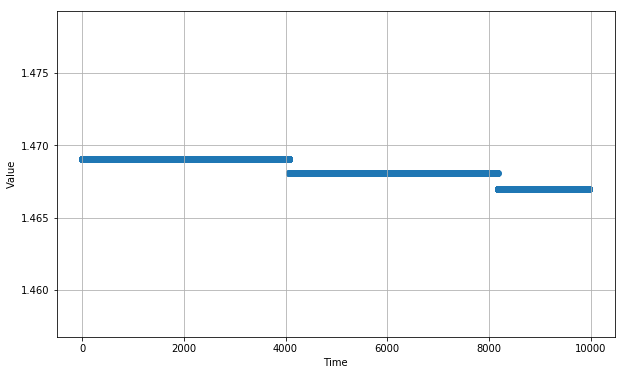

In [24]:
plt.figure(figsize=(10, 6))
plot_series(time, target)

In [34]:
pd.Series(target).value_counts()

0.0    436
1.0     24
dtype: int64

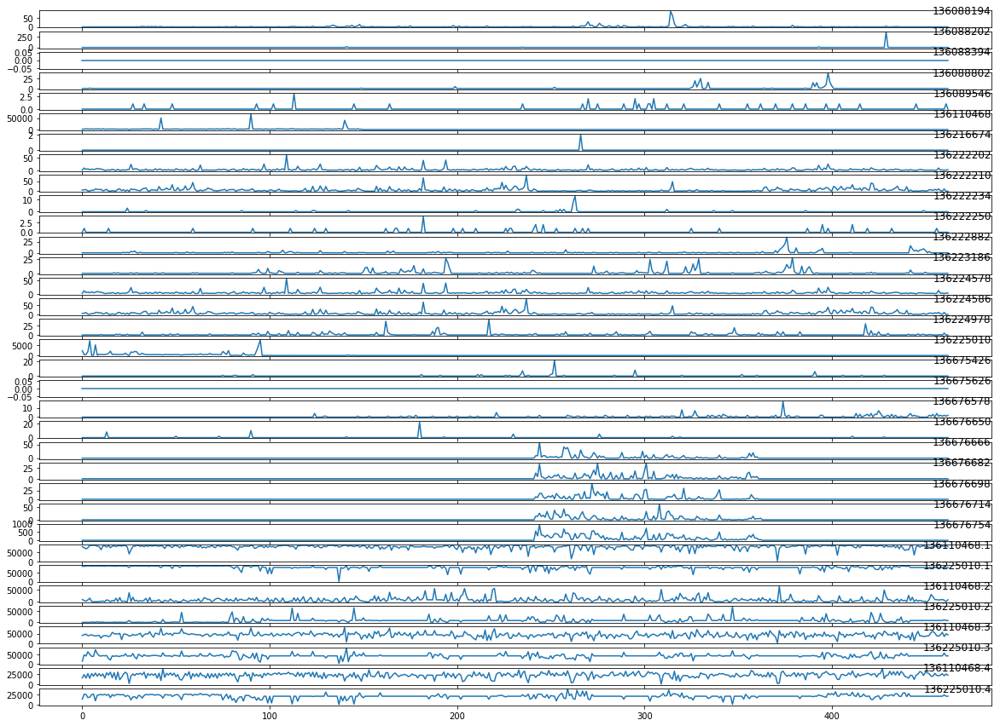

In [35]:
values = features.drop(['date','label'],axis=1).values
# specify columns to plot
groups = [i for i in range(0,34)]
i = 1
# plot each column
plt.figure(figsize=(20,15))
for group in groups:
    plt.subplot(len(groups), 1, i)
    plt.plot(values[:, group])
    plt.title(features.drop(['date','label'],axis=1).columns[group], y=0.5, loc='right')
    i += 1
plt.show()

In [36]:
split_time = 300
time_train = time[:split_time]
x_train = dataset[:split_time]
y_train = labels[:split_time]
time_valid = time[split_time:]
x_valid = dataset[split_time:]
y_valid = target[split_time:]


In [37]:
len(time),len(datset),len(target)

(460, 460, 460)

In [38]:
x_valid.shape


(160, 3, 34)

In [39]:
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras import Input, layers
from tensorflow.keras import backend as K
import tensorflow as tf

In [40]:
model = tf.keras.models.Sequential([
tf.keras.layers.Conv1D(filters=60, kernel_size=5,
                      strides=1, padding="causal",
                      activation="relu",
                      input_shape=(window_size,34)),
tf.keras.layers.LSTM(256, return_sequences=True),
tf.keras.layers.LSTM(128, return_sequences=True),
tf.keras.layers.Flatten(),
tf.keras.layers.Dense(32, activation="relu"),
tf.keras.layers.Dense(1,activation='sigmoid')])

In [42]:
x_train = x_train.reshape((300,window_size,34))
x_valid = x_valid.reshape((160,window_size,34))

In [43]:
model.compile(optimizer=tf.keras.optimizers.Adam(), loss=tf.keras.losses.BinaryCrossentropy()
              , metrics=['accuracy'])

In [44]:
model.fit(x_train,np.array(y_train),batch_size=32,steps_per_epoch=np.ceil(x_train.shape[0] / 32),epochs=10,validation_data=(x_valid,np.array(y_valid)))


W1116 17:23:37.196451  7212 deprecation.py:323] From c:\users\lenovo_pc\appdata\local\programs\python\python37\lib\site-packages\tensorflow\python\ops\math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 10.0 samples, validate on 160 samples
Epoch 1/10
10/10 [==============================] - 4s 429ms/step - loss: 0.5160 - accuracy: 0.9033 - val_loss: 0.2847 - val_accuracy: 0.9312
Epoch 2/10
10/10 [==============================] - 1s 131ms/step - loss: 0.2229 - accuracy: 0.9600 - val_loss: 0.2933 - val_accuracy: 0.9312
Epoch 3/10
10/10 [==============================] - 1s 134ms/step - loss: 0.1562 - accuracy: 0.9600 - val_loss: 0.2641 - val_accuracy: 0.9312
Epoch 4/10
10/10 [==============================] - 1s 134ms/step - loss: 0.1285 - accuracy: 0.9600 - val_loss: 0.3083 - val_accuracy: 0.9312
Epoch 5/10
10/10 [==============================] - 1s 134ms/step - loss: 0.0962 - accuracy: 0.9690 - val_loss: 0.3518 - val_accuracy: 0.9250
Epoch 6/10
10/10 [==============================] - 2s 162ms/step - loss: 0.0642 - accuracy: 0.9823 - val_loss: 0.4116 - val_accuracy: 0.9062
Epoch 7/10
10/10 [==============================] - 1s 141ms/step - loss: 0.0315 - accuracy: 0.9943 -

In [45]:
np.array(y_train).shape

(300,)

In [ ]:
model.summary()